In [13]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import matplotlib.patches as mpatches
from wordcloud import WordCloud
from sklearn.metrics.pairwise import cosine_similarity
from collections import Counter


In [2]:
# Cargar los datos
df_steam_games = pd.read_csv('../datasets/df_steam_games_clean.csv')
df_user_reviews = pd.read_csv('../datasets/df_user_reviews_clean.csv')
df_user_items = pd.read_csv('../datasets/df_user_items_clean.csv.gz',compression='gzip')

In [3]:
df_steam_games

,genres,title,release_date,price,id,developer
0,"['Action', 'Casual', 'Indie', 'Simulation', 'S...",Lost Summoner Kitty,2018,4.99,761140.0,Kotoshiro
1,"['Free to Play', 'Indie', 'RPG', 'Strategy']",Ironbound,2018,0.00,643980.0,Secret Level SRL
2,"['Casual', 'Free to Play', 'Indie', 'Simulatio...",Real Pool 3D - Poolians,2017,0.00,670290.0,Poolians.com
3,"['Action', 'Adventure', 'Casual']",弹炸人2222,2017,0.99,767400.0,彼岸领域
4,"['Action', 'Adventure', 'Simulation']",Battle Royale Trainer,2018,3.99,772540.0,Trickjump Games Ltd
...,...,...,...,...,...,...
27516,"['Action', 'Adventure', 'Casual', 'Indie']",Kebab it Up!,2018,1.99,745400.0,Bidoniera Games
27517,"['Casual', 'Indie', 'Simulation', 'Strategy']",Colony On Mars,2018,1.99,773640.0,"Nikita ""Ghost_RUS"""
27518,"['Casual', 'Indie', 'Strategy']",LOGistICAL: South Africa,2018,4.99,733530.0,Sacada
27519,"['Indie', 'Racing', 'Simulation']",Russian Roads,2018,1.99,610660.0,Laush Dmitriy Sergeevich


In [94]:
df_user_reviews.head()

,user_id,item_id,recommend,sentiment_analysis
0,76561197970982479,1250,True,2
1,76561197970982479,22200,True,2
2,76561197970982479,43110,True,2
3,js41637,251610,True,2
4,js41637,227300,True,2


In [95]:
df_user_items.head()

,user_id,items_count,items
0,76561197970982479,277,"[{'item_id': '10', 'item_name': 'Counter-Strik..."
1,js41637,888,"[{'item_id': '10', 'item_name': 'Counter-Strik..."
2,evcentric,137,"[{'item_id': '1200', 'item_name': 'Red Orchest..."
3,Riot-Punch,328,"[{'item_id': '10', 'item_name': 'Counter-Strik..."
4,doctr,541,"[{'item_id': '300', 'item_name': 'Day of Defea..."


In [4]:
df_steam_games["genres"] = df_steam_games["genres"].apply(lambda x: eval(x))

In [ ]:
# # Primero, unimos los dos DataFrames en las columnas 'item_id' y 'id'
# df = pd.merge(df_user_reviews, df_steam_games, left_on='item_id', right_on='id')

# # Luego, agrupamos los datos por 'title' y calculamos la media de las calificaciones para cada juego
# game_ratings = df.groupby('title')['recommend'].mean()

# # Ahora, cada juego está representado por un vector de características que es la media de las calificaciones otorgadas a ese juego
# vectors = game_ratings.values

# # Convertimos los vectores en una matriz para calcular la similitud del coseno
# features = vectors.reshape(-1, 1)

# # Calculamos la similitud del coseno entre todos los juegos
# similarity_matrix = cosine_similarity(features)

# # Creamos el diccionario de mapeo
# game_id_to_index = {id: index for index, id in enumerate(df_steam_games['id'])}

# # Modificamos la función para que acepte un ID de producto
# def recommend_games(game_id, game_id_to_index, similarity_matrix, num_recommendations=5):
#     # Obtenemos el índice del juego dado
#     game_index = game_id_to_index[game_id]
    
#     # Calculamos las similitudes del coseno entre el juego dado y todos los demás juegos
#     similarities = similarity_matrix[game_index]
    
#     # Encontramos los índices de los juegos más similares
#     similar_game_indices = similarities.argsort()[-num_recommendations:][::-1]
    
#     # Obtenemos los ID de los juegos más similares
#     similar_game_ids = df_steam_games.iloc[similar_game_indices]['id'].tolist()
#     similar_game_titles = df_steam_games.iloc[similar_game_indices]['title'].tolist()
    
#     # Devolvemos los ID de los juegos más similares
#     return list(zip(similar_game_ids, similar_game_titles))
#     #return similar_game_ids

# # Recomendamos juegos similares al juego con ID 0
# recommend_games(745400, game_id_to_index, similarity_matrix)

In [5]:
#eval(df_steam_games["genres"].iloc[47])

In [6]:
# for generos in df_steam_games['genres']:
#     for genero in generos:
#         print(genero)
#     break

In [5]:
listaDeGeneros = []
for generos in df_steam_games['genres']:
  for genero in generos:
    if ('genres_'+ genero) not in listaDeGeneros:
      listaDeGeneros.append('genres_'+ genero)

df_steam_games[listaDeGeneros] = 0

for indice, generos in enumerate(df_steam_games['genres']):
  for genero in generos:
    df_steam_games['genres_'+ genero].iloc[indice] = 1

C:\Users\jeffe\AppData\Local\Temp\ipykernel_2812\4121473815.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_steam_games[listaDeGeneros] = 0
C:\Users\jeffe\AppData\Local\Temp\ipykernel_2812\4121473815.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_steam_games[listaDeGeneros] = 0
C:\Users\jeffe\AppData\Local\Temp\ipykernel_2812\4121473815.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all column

In [6]:
df_steam_games.head()

,genres,title,release_date,price,id,developer,genres_Action,genres_Casual,genres_Indie,genres_Simulation,...,genres_Beat 'em up,genres_Time Travel,genres_Remake,genres_Time Attack,genres_Documentary,genres_Controller,genres_Memes,genres_Detective,genres_Mystery,genres_Episodic
0,"[Action, Casual, Indie, Simulation, Strategy]",Lost Summoner Kitty,2018,4.99,761140.0,Kotoshiro,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,"[Free to Play, Indie, RPG, Strategy]",Ironbound,2018,0.00,643980.0,Secret Level SRL,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
2,"[Casual, Free to Play, Indie, Simulation, Sports]",Real Pool 3D - Poolians,2017,0.00,670290.0,Poolians.com,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
3,"[Action, Adventure, Casual]",弹炸人2222,2017,0.99,767400.0,彼岸领域,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0
4,"[Action, Adventure, Simulation]",Battle Royale Trainer,2018,3.99,772540.0,Trickjump Games Ltd,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [8]:
df_steam_games.loc[df_steam_games["release_date"] == "2021"]

,genres,title,release_date,price,id,developer,genres_Action,genres_Casual,genres_Indie,genres_Simulation,...,genres_Beat 'em up,genres_Time Travel,genres_Remake,genres_Time Attack,genres_Documentary,genres_Controller,genres_Memes,genres_Detective,genres_Mystery,genres_Episodic


In [12]:
features = pd.get_dummies(df_steam_games['genres'])
vectors = features.values
vectors

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [9]:
# # Contar el número de juegos por género
# print(df_steam_games['genres'].value_counts())

# # Contar el número de juegos por desarrollador
# print(df_steam_games['developer'].value_counts())

In [10]:
# generos = []
# cantidad = []
# for genero in listaDeGeneros:
#     generos.append(genero.replace('genres_',''))
#     cantidad.append(df_steam_games[genero].value_counts()[1])

# juegos = pd.DataFrame()
# juegos['Genero'] = generos
# juegos['Cantidad'] = cantidad

# plt.figure(figsize=(12, 6)) 
# sns.barplot(data = juegos, x='Genero', y='Cantidad')
# plt.xticks(rotation=90)
# plt.show()

In [ ]:
# generos = [genero.replace('genres_','') for genero in listaDeGeneros]
# cantidad = [df_steam_games[genero].value_counts()[1] for genero in listaDeGeneros]

# juegos = pd.DataFrame({'Genero': generos, 'Cantidad': cantidad})

# plt.figure(figsize=(12, 6)) 
# sns.barplot(data = juegos, x='Genero', y='Cantidad')
# plt.xticks(rotation=90)
# plt.show()

C:\Users\jeffe\AppData\Local\Temp\ipykernel_2812\3124508199.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=juegos, x='Genero', y='Cantidad', palette='pastel')


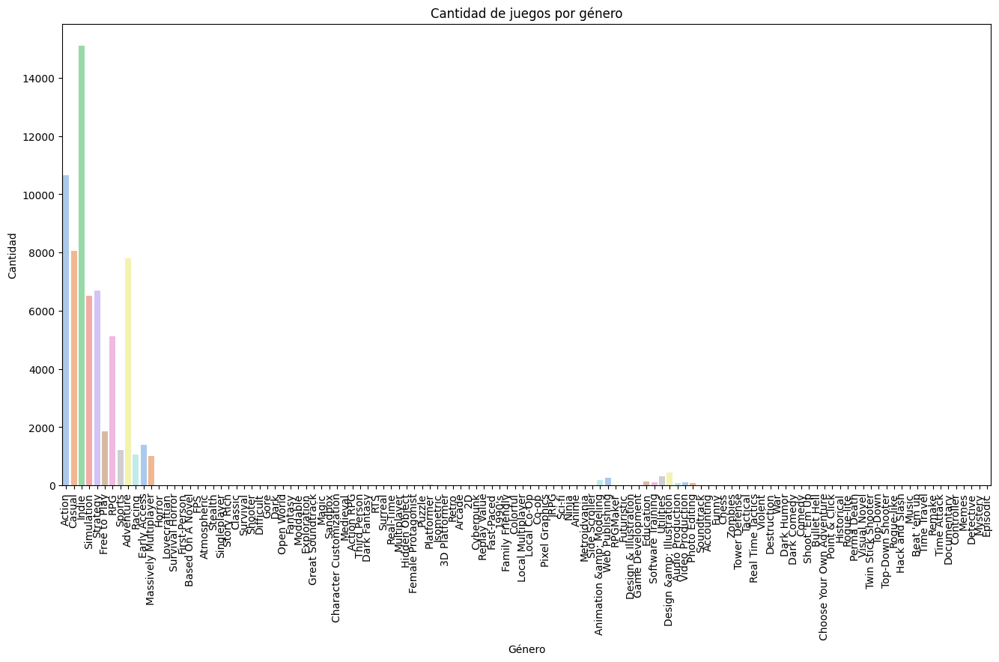

In [9]:
# Código para generar los datos
generos = [genero.replace('genres_','') for genero in listaDeGeneros]
cantidad = [df_steam_games[genero].value_counts()[1] for genero in listaDeGeneros]

juegos = pd.DataFrame({'Genero': generos, 'Cantidad': cantidad})

# Configuración del gráfico
plt.figure(figsize=(16, 8)) 
plt.title('Cantidad de juegos por género')
plt.xlabel('Género')
plt.ylabel('Cantidad')
plt.xticks(rotation=90)

# Creación del gráfico
sns.barplot(data=juegos, x='Genero', y='Cantidad', palette='pastel')

# Mostrar el gráfico
plt.show()

C:\Users\jeffe\AppData\Local\Temp\ipykernel_14792\314446483.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('PuBuGn', len(games_per_year))


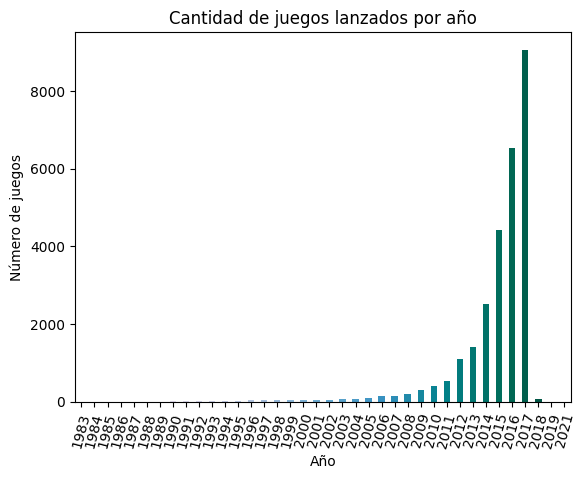

In [52]:
df_steam_games['release_date'] = df_steam_games['release_date'].astype(str)
games_per_year = df_steam_games['release_date'].value_counts().sort_index()

cmap = plt.cm.get_cmap('PuBuGn', len(games_per_year))
# Generar una lista de colores
colors = cmap(np.arange(len(games_per_year)))
# Crear el gráfico de barras con colores personalizados
games_per_year.plot(kind='bar', color=colors)
plt.title('Cantidad de juegos lanzados por año')
plt.xlabel('Año')
plt.ylabel('Número de juegos')
plt.xticks(rotation=75)
plt.show()


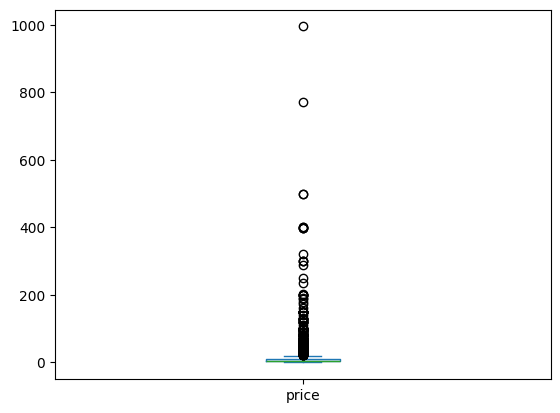

<Figure size 1500x2000 with 0 Axes>

In [93]:
boxplot = df_steam_games['price'].plot.box()

plt.figure(figsize=(15,20))
plt.show()


## df_user_reviews

In [19]:
df_user_reviews.head()

,user_id,item_id,recommend,sentiment_analysis
0,76561197970982479,1250,True,2
1,76561197970982479,22200,True,2
2,76561197970982479,43110,True,2
3,js41637,251610,True,2
4,js41637,227300,True,2


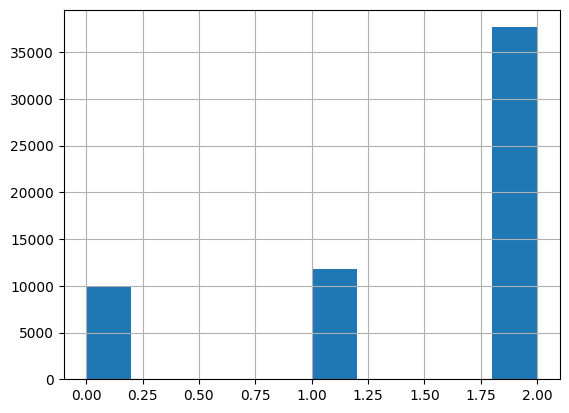

In [17]:
df_user_reviews["sentiment_analysis"].hist()
plt.show()

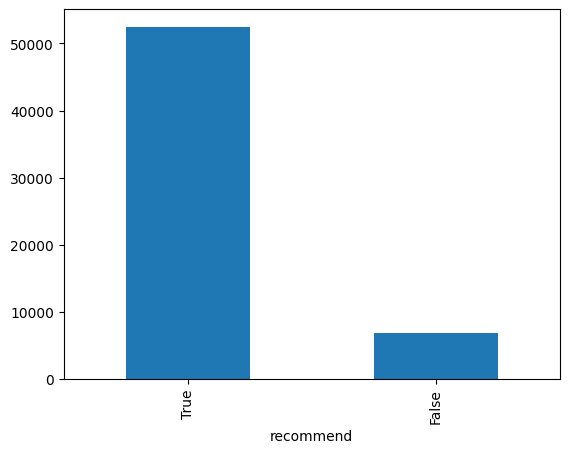

In [18]:
df_user_reviews["recommend"].value_counts().plot(kind="bar")
plt.show()

### relacion 

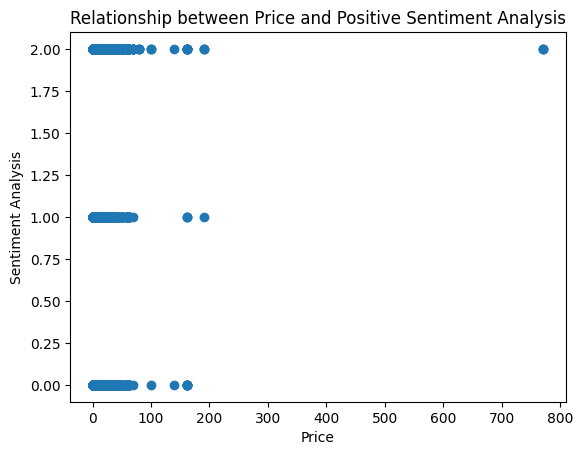

In [21]:
# Filtrar el segundo dataframe
df_user_reviews_positive = df_user_reviews[df_user_reviews['sentiment_analysis'].isin([2,0,1])]

# Unir los dos dataframes
df_merged = pd.merge(df_steam_games, df_user_reviews_positive, left_on='id', right_on='item_id')

# Crear el gráfico

plt.scatter(df_merged['price'], df_merged['sentiment_analysis'])
plt.xlabel('Price')
plt.ylabel('Sentiment Analysis')
plt.title('Relationship between Price and Positive Sentiment Analysis')
plt.show()

In [22]:
# Reducir los dataframes a las columnas necesarias
df_user_reviews = df_user_reviews[['user_id', 'item_id', 'sentiment_analysis']]
df_steam_games = df_steam_games[['title', 'id']]

# Unir los dos dataframes
df_merged = pd.merge(df_user_reviews, df_steam_games, left_on='item_id', right_on='id')

# Agrupar por 'user_id' y 'sentiment_analysis', y obtener los títulos en los que coinciden
df_grouped = df_merged.groupby(['user_id', 'sentiment_analysis'])['title'].apply(list)

# Convertir el resultado a un DataFrame para mejor visualización
df_grouped = df_grouped.reset_index()

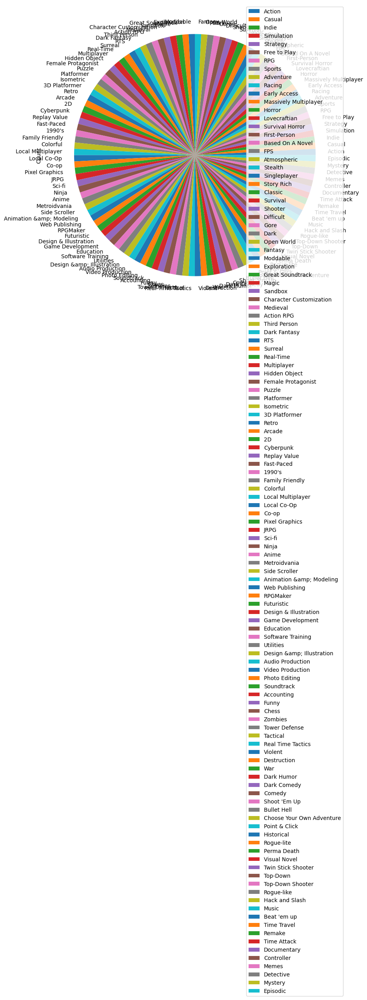

In [14]:
generos = [genero.replace('genres_','') for genero in listaDeGeneros]
genre_counts = Counter(generos)

# Create a DataFrame from the counter
df = pd.DataFrame.from_dict(genre_counts, orient='index', columns=['Count'])

# Plot a pie chart
df.plot.pie(y='Count', figsize=(10, 10))
plt.show()